In [101]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
data='../../rna/'

In [102]:
a=['SRR10836663','SRR10836666','SRR10836680']
t=['SRR10836677','SRR10836679','SRR10836678']
y=['SRR10836675','SRR10836676']
for s in a+t+y:
    if s=='SRR10836663':
        df=pd.read_csv(data+'end/'+s+'/quant.sf',sep='\t',index_col=0)[['TPM']]
        df.columns=[s]
    else:
        d=pd.read_csv(data+'end/'+s+'/quant.sf',sep='\t',index_col=0)[['TPM']]
        d.columns=[s]
        df=df.merge(d,left_index=True,right_index=True)
df=df[t+y+a].round(2)
t=['Treated_1','Treated_2','Treated_3']
y=['Young_1','Young_2']
a=['Aged_1','Aged_2','Aged_3']
df.columns=t+y+a
print(df.shape)
df.sum().values

(177456, 8)


array([1000000.59,  999999.97,  999998.66,  999999.55,  999998.44,
       1000000.82, 1000000.79,  999999.74])

In [103]:
dg=pd.read_csv('../data/mart_export.txt.gz',sep='\t',index_col=3)[['Gene name']]
dg=dg.rename(columns={'Gene name':'gene'})
dg.shape

(256183, 1)

In [104]:
df.index=df.index.str[:-2]
dg.index=dg.index.str[:-2]
df=df.merge(dg,left_index=True,right_index=True)
df.drop('gene',1).sum().values

array([988754.45, 988002.32, 983149.85, 989555.91, 990236.7 , 988061.36,
       992212.55, 993094.7 ])

In [105]:
yam=['POU5F1','NANOG','SOX2','KLF4','LIN28A','MYC','POU5F1P3','POU5F1P4']
(df[df.gene.isin(yam)].drop('gene',1).sum()/(10**6)).round(3)

Treated_1    0.002
Treated_2    0.001
Treated_3    0.001
Young_1      0.000
Young_2      0.000
Aged_1       0.000
Aged_2       0.000
Aged_3       0.000
dtype: float64

In [106]:
df[df.gene.isin(yam)].sort_values(t[0]).tail(10)

,Treated_1,Treated_2,Treated_3,Young_1,Young_2,Aged_1,Aged_2,Aged_3,gene
ENST00000254231,57.57,36.72,0.00,0.00,0.00,0.00,0.00,0.00,LIN28A
ENST00000497367,59.31,31.36,75.19,0.00,0.00,0.00,0.00,0.00,POU5F1
ENST00000497087,59.32,31.65,75.19,0.00,0.00,0.00,0.00,0.00,POU5F1
ENST00000497048,83.25,42.39,12.34,0.89,1.93,0.00,1.23,0.07,KLF4
ENST00000541267,112.95,72.16,37.84,0.00,0.00,0.00,0.00,0.00,NANOG
ENST00000325404,123.78,61.00,41.09,0.13,0.04,0.06,0.00,0.00,SOX2
ENST00000411706,128.90,72.14,33.72,0.00,0.00,0.00,0.34,0.00,KLF4
ENST00000638788,148.25,76.93,0.00,0.00,0.00,0.00,0.00,0.00,POU5F1
ENST00000526286,218.62,144.89,22.03,0.00,0.00,0.00,0.00,0.00,NANOG
ENST00000454714,694.69,412.20,140.40,0.37,0.06,0.00,0.00,0.00,POU5F1


In [107]:
df['T']=df[t].mean(1).round(2)
df['Y']=df[y].mean(1).round(2)
df['A']=df[a].mean(1).round(2)
df.loc[df.A>0,'T_vs_A_fold']=df['T']/df['A']
df.loc[df.A>0,'Y_vs_A_fold']=df['Y']/df['A']
df.shape

(175741, 14)

In [108]:
np.log(df[~df.gene.isin(yam)][['T_vs_A_fold','Y_vs_A_fold']]).corr()

,T_vs_A_fold,Y_vs_A_fold
T_vs_A_fold,1.000000,0.635431
Y_vs_A_fold,0.635431,1.000000


In [109]:
fig = px.scatter(df, x="T_vs_A_fold", y="Y_vs_A_fold", log_x=True,log_y=True,width=1000, height=1000, hover_data=['gene','T','Y','A'],
                labels={
                     "T_vs_A_fold": "Trated vs Aged",
                     "Y_vs_A_fold": "Young vs Aged",
                 },
                )
fig.show()

In [72]:
dg=df.groupby('gene').sum()
dg.loc[dg.A>0,'T_vs_A_fold']=dg['T']/dg['A']
dg.loc[dg.A>0,'Y_vs_A_fold']=dg['Y']/dg['A']

In [90]:
dg[dg.Y==0].sort_values('A',ascending=False).head(50)

,Treated_1,Treated_2,Treated_3,Young_1,Young_2,Aged_1,Aged_2,Aged_3,T,Y,A,T_vs_A_fold,Y_vs_A_fold
gene,,,,,,,,,,,,,
GAGE12B,0.00,0.00,93.36,0.0,0.0,186.47,0.00,0.00,31.12,0.0,62.16,0.500644,0.0
RNA5SP349,0.00,0.00,0.00,0.0,0.0,136.24,0.00,0.00,0.00,0.0,45.41,0.000000,0.0
AC233724.3,0.00,0.00,0.00,0.0,0.0,109.45,0.00,0.00,0.00,0.0,36.48,0.000000,0.0
AC011998.1,0.00,0.00,0.00,0.0,0.0,93.24,0.00,0.00,0.00,0.0,31.08,0.000000,0.0
AL445264.1,0.00,0.00,29.53,0.0,0.0,86.69,0.00,0.00,9.84,0.0,28.90,0.340484,0.0
AL627311.1,0.00,0.00,0.00,0.0,0.0,84.23,0.00,0.00,0.00,0.0,28.08,0.000000,0.0
RNA5SP429,0.00,0.00,0.00,0.0,0.0,66.13,11.00,0.00,0.00,0.0,25.71,0.000000,0.0
RNA5SP278,0.00,0.00,0.00,0.0,0.0,75.42,0.00,0.00,0.00,0.0,25.14,0.000000,0.0
CR383656.7,0.00,0.00,0.00,0.0,0.0,73.99,0.00,0.00,0.00,0.0,24.66,0.000000,0.0


In [110]:
f='https://static-content.springer.com/esm/art%3A10.1038%2Fs41467-020-15174-3/MediaObjects/41467_2020_15174_MOESM6_ESM.xlsx'
f=pd.read_excel(f,index_col=0)
g=f.index.str.strip()
dg=df[df.gene.isin(g)].groupby('gene').sum()
dg['T']=dg[t].mean(1).round(2)
dg['Y']=dg[y].mean(1).round(2)
dg['A']=dg[a].mean(1).round(2)
#dg['T_vs_A_fold']=((dg['T'])/(dg.A))#.round(4)
#dg['Y_vs_A_fold']=((dg.Y)/(dg.A))#.round(4)
dg[dg.A>1].sort_values('Y_vs_A_fold').head(50)

/home/moqri/anaconda3/envs/era/lib/python3.9/site-packages/openpyxl/worksheet/_reader.py:312: UserWarning:

Unknown extension is not supported and will be removed



,Treated_1,Treated_2,Treated_3,Young_1,Young_2,Aged_1,Aged_2,Aged_3,T,Y,A,T_vs_A_fold,Y_vs_A_fold
gene,,,,,,,,,,,,,
NPFF,0.00,0.00,0.00,0.00,0.00,1.70,1.17,0.54,0.00,0.00,1.14,0.000000,0.000000
TNFSF18,80.02,66.53,17.31,5.13,3.83,16.88,53.14,32.22,54.62,4.48,34.08,1.602700,0.131455
PMCH,3.32,1.87,8.25,2.65,0.86,16.35,3.43,3.74,4.48,1.76,7.84,0.571429,0.224490
HOXD1,16.00,12.59,11.82,0.94,1.27,8.60,2.51,1.45,13.47,1.10,4.19,3.214797,0.262530
GCHFR,18.00,13.36,12.10,6.54,1.81,18.86,14.06,13.89,14.49,4.18,15.60,1.445198,0.302679
MRPL12,208.35,255.52,258.36,126.73,111.30,338.40,300.99,259.36,240.74,119.02,299.58,0.803592,0.397290
PPIAL4A,0.88,0.55,0.00,0.15,0.76,0.65,1.38,1.29,0.48,0.46,1.11,0.432432,0.414414
RMI2,3.88,5.58,4.88,1.80,2.10,3.36,6.45,3.04,4.78,1.95,4.28,0.775701,0.448598
GJC2,0.48,0.40,3.03,1.14,0.24,3.21,0.60,0.71,1.30,0.69,1.51,0.860927,0.456954


In [111]:
df[t+y+a][df[t+y+a]>0].count().sort_values(ascending=False)

Young_2      84607
Treated_2    75080
Treated_1    71569
Young_1      65511
Aged_2       65295
Aged_3       57025
Aged_1       53853
Treated_3    47787
dtype: int64

(8, 175741)


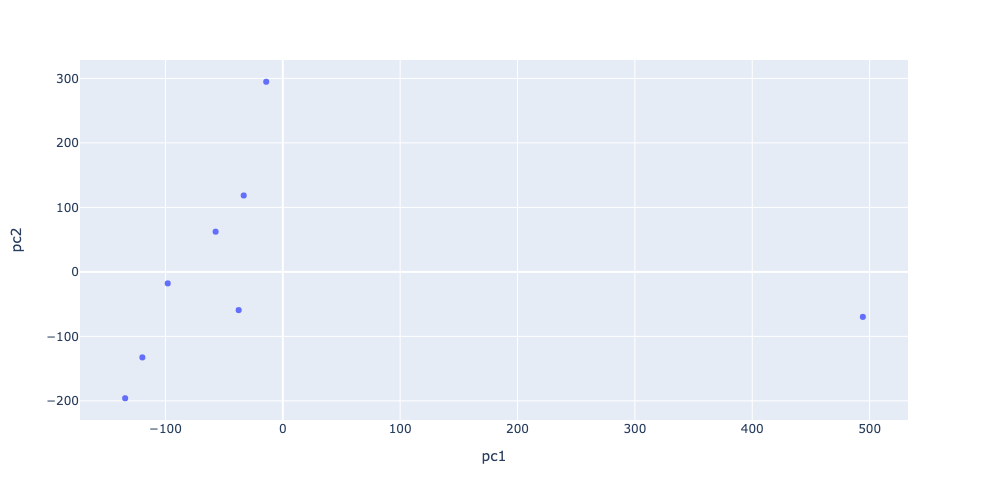

In [113]:
x = StandardScaler().fit_transform(df[t+y+a].T)
print(x.shape)
pca = PCA(n_components=2)
principalComponents = pca.fit_transform(x)
dg = pd.DataFrame(data = principalComponents
             , columns = ['pc1', 'pc2'])
dg.index=df[t+y+a].T.index
dg['sample']=dg.index
fig = px.scatter(dg, x="pc1", y="pc2",width=500, height=500, hover_data=['sample'],)
fig.show()